In [2]:
#intro to music generation with RNNS

import tensorflow as tf
tf.enable_eager_execution()
import numpy as np
import matplotlib.pyplot as plt

In [3]:
is_correct_tf_version = '1.13.' in tf.__version__
assert is_correct_tf_version, "Wrong tensorflow version {} installed".format(tf.__version__)

is_eager_enabled = tf.executing_eagerly()
assert is_eager_enabled,      "Tensorflow eager mode is not enabled"

In [4]:
#building a simple computational graph with tensors

#create the nodes in the graph, and initialize the values

a = tf.constant(20, name= "node_a")
b = tf.constant(33, name= "node_b")

c = tf.add(a,b,name="c")
print(c)

tf.Tensor(53, shape=(), dtype=int32)


In [5]:
def graph(a,b):
    c = tf.subtract(a,b,name="c")
    d = tf.multiply(c,a,name="d")
    e = tf.math.square(b, name="e")
    f = tf.add(e, d, name="f")
    return f

a, b = 4.5, 3.9

f_out = graph(a,b)

print(f_out)
    

tf.Tensor(17.91, shape=(), dtype=float32)


In [6]:
#simple neural network with just one dense layer
#n_in :# of inputs, n_out : # of inputs


def dense_layer(x, n_in, n_out):
    #init the weight matrix and biases
    W = tf.Variable(tf.ones((n_in, n_out), tf.float32))
    b = tf.Variable(tf.zeros((n_out), tf.float32))
    
    z = tf.matmul(x, W) + b
    
    out = tf.sigmoid(z)
    return out 

In [7]:
test_input = [[0.25, 0.15]]

output = dense_layer(test_input, 2, 1)

print(output)

Instructions for updating:
Colocations handled automatically by placer.
tf.Tensor([[0.59868765]], shape=(1, 1), dtype=float32)


intitializing x=[[1.062052]]


Text(0,0.5,'x value')

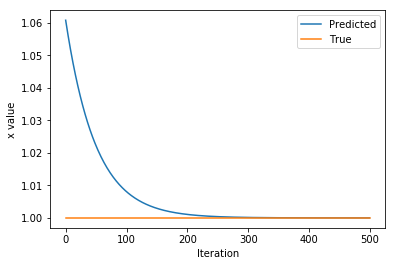

In [46]:
#automatic differentation 
#in tf eager execution, use tf.GradientTape to trace operations for computing gradients during backwards pass

x = tf.Variable([tf.random.normal([1])])
print( "intitializing x={}".format(x.numpy()))
learning_rate = 1e-2
history = []

for i in range(500):
    with tf.GradientTape() as tape:
        y = (x-1)**2 #record forward pass onto the gradient tape
        
    grad = tape.gradient(y, x) #compute grad of y respect to x
    new_x = x - learning_rate * grad #sgd update
    x.assign(new_x) #update the value of x
    history.append(x.numpy()[0])
    
plt.plot(history)
plt.plot([0, 500],[1,1])
plt.legend(('Predicted', 'True'))
plt.xlabel('Iteration')
plt.ylabel('x value')
        

In [53]:
import os
import subprocess
import regex as re
import time
import functools 

import matplotlib.pyplot as plt
from IPython import display as ipythondisplay


#####################################
def custom_progress_text(message):
  import progressbar
  from string import Formatter

  message_ = message.replace('(', '{')
  message_ = message_.replace(')', '}')

  keys = [key[1] for key in Formatter().parse(message_)]

  ids = {}
  for key in keys:
    if key is not None:
      ids[key] = float('nan')

  msg = progressbar.FormatCustomText(message, ids)
  return msg

def create_progress_bar(text=None):
  import progressbar
  if text is None:
    text = progressbar.FormatCustomText('')
  bar = progressbar.ProgressBar(widgets=[
      progressbar.Percentage(),
      progressbar.Bar(),
      progressbar.AdaptiveETA(), '  ',
      text,
  ])
  return bar

def display_model(model):
  tf.keras.utils.plot_model(model,
             to_file='tmp.png',
             show_shapes=True)
  from IPython.display import Image
  return Image('tmp.png')


def plot_sample(x,y,vae):
    plt.figure(figsize=(2,1))
    plt.subplot(1, 2, 1)

    idx = np.where(y.numpy()==1)[0][0]
    plt.imshow(x[idx])
    plt.grid(False)

    plt.subplot(1, 2, 2)
    plt.imshow(vae(x)[idx])
    plt.grid(False)

    plt.show()


class LossHistory:
  def __init__(self, smoothing_factor=0.0):
    self.alpha = smoothing_factor
    self.loss = []
  def append(self, value):
    self.loss.append( self.alpha*self.loss[-1] + (1-self.alpha)*value if len(self.loss)>0 else value )
  def get(self):
    return self.loss

class PeriodicPlotter:
    def __init__(self, sec, xlabel='', ylabel='', scale=None):
        from IPython import display as ipythondisplay
        import matplotlib.pyplot as plt
        import time

        self.xlabel = xlabel
        self.ylabel = ylabel
        self.sec = sec
        self.scale = scale

        self.tic = time.time()

    def plot(self, data):
        if time.time() - self.tic > self.sec:
            plt.cla()
      
            if self.scale is None:
                plt.plot(data)
            elif self.scale == 'semilogx':
                plt.semilogx(data)
            elif self.scale == 'semilogy':
                plt.semilogy(data)
            elif self.scale == 'loglog':
                plt.loglog(data)
            else:
                raise ValueError("unrecognized parameter scale {}".format(self.scale))

            plt.xlabel(self.xlabel); plt.ylabel(self.ylabel)
            ipythondisplay.clear_output(wait=True)
            ipythondisplay.display(plt.gcf())

            self.tic = time.time()




def extract_song_snippet(generated_text):
    pattern = '\n\n(.*?)\n\n'
    search_results = re.findall(pattern, generated_text, overlapped=True, flags=re.DOTALL)
    songs = [song for song in search_results]
    print("Found {} possible songs in generated texts".format(len(songs)))
    return songs

def save_song_to_abc(song, filename="tmp"):
    save_name = "{}.abc".format(filename)
    with open(save_name, "w") as f:
        f.write(song)
    return filename

def abc2wav(abc_file):
    path_to_tool = './introtodeeplearning_labs/lab1/abc2wav'
    cmd = "{} {}".format(path_to_tool, abc_file)
    return os.system(cmd)

def play_wav(wav_file):
    from IPython.display import Audio
    return Audio(wav_file)

def play_generated_song(generated_text):
    songs = extract_song_snippet(generated_text)
    if len(songs) == 0:
        print("No valid songs found in generated text. Try training the model longer or increasing the amount of generated music to ensure complete songs are generated!")

    for song in songs:
        basename = save_song_to_abc(song)
        ret = abc2wav(basename+'.abc')
        if ret == 0: #did not suceed
            return play_wav(basename+'.wav')
    print("None of the songs were valid, try training longer to improve syntax.")



In [54]:
dir(progressbar)

NameError: name 'progressbar' is not defined

In [55]:
! git clone https://github.com/aamini/introtodeeplearning_labs.git
% cd introtodeeplearning_labs
! git pull
% cd ..

fatal: destination path 'introtodeeplearning_labs' already exists and is not an empty directory.
/Users/arusnak/ML/MIT_DL/introtodeeplearning_labs
Already up to date.
/Users/arusnak/ML/MIT_DL


In [56]:
path_to_file = tf.keras.utils.get_file('irish.abc', 'https://raw.githubusercontent.com/aamini/introtodeeplearning_labs/2019/lab1/data/irish.abc')

In [57]:
text = open(path_to_file).read()
# length of text is the number of characters in it
print ('Length of text: {} characters'.format(len(text)))

Length of text: 197618 characters


In [58]:
play_generated_song(text)

Found 816 possible songs in generated texts


In [59]:

print(text[:250])

X:1
T:Alexander's
Z: id:dc-hornpipe-1
M:C|
L:1/8
K:D Major
(3ABc|dAFA DFAd|fdcd FAdf|gfge fefd|(3efe (3dcB A2 (3ABc|!
dAFA DFAd|fdcd FAdf|gfge fefd|(3efe dc d2:|!
AG|FAdA FAdA|GBdB GBdB|Acec Acec|dfaf gecA|!
FAdA FAdA|GBdB GBdB|Aceg fefd|(3efe dc d2:


In [60]:
vocab = sorted(set(text))
print ('{} unique characters'.format(len(vocab)))

83 unique characters


In [61]:
#vectorize the text 
# two lookup tables,; one to map characters to numbers, and vice versa

#creating a mapping from unique characters to indices
char2idx = {u:i for i, u in enumerate(vocab)}
text_as_int = np.array([char2idx[c] for c in text])

idx2char = np.array(vocab)

In [62]:
print('{')
for char,_ in zip(char2idx, range(20)):
    print('  {:4s}: {:3d},'.format(repr(char), char2idx[char]))
print('  ...\n}')

{
  '\n':   0,
  ' ' :   1,
  '!' :   2,
  '"' :   3,
  '#' :   4,
  "'" :   5,
  '(' :   6,
  ')' :   7,
  ',' :   8,
  '-' :   9,
  '.' :  10,
  '/' :  11,
  '0' :  12,
  '1' :  13,
  '2' :  14,
  '3' :  15,
  '4' :  16,
  '5' :  17,
  '6' :  18,
  '7' :  19,
  ...
}


In [63]:
x = char2idx[' ']
if x == 1:
    print('here')

here


In [64]:
print ('{} ---- characters mapped to int ---- > {}'.format(repr(text[:13]), text_as_int[:250]))

'X:1\nT:Alexand' ---- characters mapped to int ---- > [49 22 13  0 45 22 26 67 60 79 56 69 59 60 73  5 74  0 51 22  1 64 59 22
 59 58  9 63 70 73 69 71 64 71 60  9 13  0 38 22 28 82  0 37 22 13 11 20
  0 36 22 29  1 38 56 65 70 73  0  6 15 26 27 58 82 59 26 31 26  1 29 31
 26 59 82 61 59 58 59  1 31 26 59 61 82 62 61 62 60  1 61 60 61 59 82  6
 15 60 61 60  1  6 15 59 58 27  1 26 14  1  6 15 26 27 58 82  2  0 59 26
 31 26  1 29 31 26 59 82 61 59 58 59  1 31 26 59 61 82 62 61 62 60  1 61
 60 61 59 82  6 15 60 61 60  1 59 58  1 59 14 22 82  2  0 26 32 82 31 26
 59 26  1 31 26 59 26 82 32 27 59 27  1 32 27 59 27 82 26 58 60 58  1 26
 58 60 58 82 59 61 56 61  1 62 60 58 26 82  2  0 31 26 59 26  1 31 26 59
 26 82 32 27 59 27  1 32 27 59 27 82 26 58 60 62  1 61 60 61 59 82  6 15
 60 61 60  1 59 58  1 59 14 22]


In [65]:
text_as_int

array([49, 22, 13, ..., 82,  2,  0])

In [66]:
seq_length = 100
examples_per_epoch = len(text)//seq_length

char_dataset = tf.data.Dataset.from_tensor_slices(text_as_int)

sequences = char_dataset.batch(
    (seq_length + 1),
    drop_remainder=True
)

In [67]:
def splitInputTarget(chunk):
    inputText = chunk[:-1]
    targetText = chunk[1:]
    print(targetText)
    return inputText, targetText

dataset = sequences.map(splitInputTarget)

Tensor("strided_slice_1:0", shape=(100,), dtype=int64)


In [68]:
for input_example, target_example in dataset.take(1):
        print(input_example)

tf.Tensor(
[49 22 13  0 45 22 26 67 60 79 56 69 59 60 73  5 74  0 51 22  1 64 59 22
 59 58  9 63 70 73 69 71 64 71 60  9 13  0 38 22 28 82  0 37 22 13 11 20
  0 36 22 29  1 38 56 65 70 73  0  6 15 26 27 58 82 59 26 31 26  1 29 31
 26 59 82 61 59 58 59  1 31 26 59 61 82 62 61 62 60  1 61 60 61 59 82  6
 15 60 61 60], shape=(100,), dtype=int64)


In [69]:
for input_example, target_example in dataset.take(1):
    for i, (input_idx, target_idx) in enumerate(zip(input_example[:5], target_example[:5])):
        print("Step {:4d}".format(i))
        print("  input: {} ({:s})".format(input_idx, repr(idx2char[input_idx])))
        print("  expected output: {} ({:s})".format(target_idx, repr(idx2char[target_idx])))

Step    0
  input: 49 ('X')
  expected output: 22 (':')
Step    1
  input: 22 (':')
  expected output: 13 ('1')
Step    2
  input: 13 ('1')
  expected output: 0 ('\n')
Step    3
  input: 0 ('\n')
  expected output: 45 ('T')
Step    4
  input: 45 ('T')
  expected output: 22 (':')


In [70]:
# Batch size 
BATCH_SIZE = 64
steps_per_epoch = examples_per_epoch//BATCH_SIZE

# Buffer size is similar to a queue size
# This defines a manageable data size to put into memory, where elements are shuffled
BUFFER_SIZE = 10000

dataset = dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE, drop_remainder=True)

# Examine the dimensions of the dataset
dataset

#define the RNN

#length of the vocabulary
vocabSize = len(vocab)

#embedding dimensions
embDim = 256

#num of RNN units
rnnUnits = 1024

LSTM = functools.partial(tf.keras.layers.LSTM, recurrent_activation="sigmoid")

LSTM = functools.partial(LSTM, return_sequences = True, recurrent_initializer='glorot_uniform', stateful=True)

In [71]:
def buildModel(vocabSize, embDim, rnnUnits, batchSize):
    model = tf.keras.Sequential([
        tf.keras.layers.Embedding(vocabSize, embDim, batch_input_shape=[batchSize, None]),
        LSTM(rnnUnits),
        tf.keras.layers.Dense(vocabSize)
    ])
    
    return model

In [72]:
model = buildModel(vocabSize, embDim, rnnUnits, BATCH_SIZE)

In [73]:
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (64, None, 256)           21248     
_________________________________________________________________
lstm (LSTM)                  (64, None, 1024)          5246976   
_________________________________________________________________
dense (Dense)                (64, None, 83)            85075     
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________


In [74]:
for inp, target in dataset.take(1):
        predictions = model(inp)

In [66]:
#sample batch before training
for input_example_batch, target_example_batch in dataset.take(1): 
    example_batch_predictions = model(input_example_batch)
    print(example_batch_predictions.shape, "# (batch_size, sequence_length, vocab_size)")

(64, 100, 83) # (batch_size, sequence_length, vocab_size)


<tf.Tensor: id=16225, shape=(64, 100, 83), dtype=float32, numpy=
array([[[-6.86020683e-03,  2.90786335e-03,  1.19709887e-03, ...,
          1.61920756e-03, -2.16690241e-03,  1.13953638e-03],
        [-1.14717828e-02,  5.55934571e-03,  1.92765193e-03, ...,
          3.16422223e-03, -3.68550094e-03,  2.07156758e-03],
        [-1.11394590e-02,  5.16980560e-03,  1.88709446e-03, ...,
          4.90711210e-03,  1.17397867e-05, -9.81322024e-03],
        ...,
        [-1.55170038e-02, -5.88278053e-05, -8.11372604e-03, ...,
          1.87434163e-03, -7.55024236e-03,  2.52213469e-03],
        [-1.22522004e-02,  2.07551150e-03, -9.26608406e-03, ...,
         -8.24885909e-04, -7.92901218e-03, -2.74303579e-03],
        [-8.56282283e-03, -5.60191576e-04, -9.43625439e-03, ...,
         -3.74253350e-03, -9.60560888e-03,  3.94718582e-03]],

       [[-7.26032024e-03,  1.83356833e-03, -4.23996476e-03, ...,
          4.18629590e-03, -2.97576189e-03,  2.17512832e-03],
        [-7.62693118e-03,  1.10914465e

In [67]:
sampled_indices = tf.random.multinomial(example_batch_predictions[0], num_samples=1)
sampled_indices = tf.squeeze(sampled_indices, axis=1).numpy()

Instructions for updating:
Use tf.random.categorical instead.


In [68]:
sampled_indices

array([49, 33, 40, 55, 62, 38, 42, 36, 54, 49,  2, 44, 69, 31, 58, 26, 53,
       79, 64,  0, 54, 11, 60, 72, 54, 72, 79,  8, 68, 13, 57, 11, 46, 36,
       33,  1, 51, 34,  7, 23, 19, 58, 47, 16, 21, 17,  8, 62, 64, 71,  4,
       34, 76, 45,  4, 65, 82, 54, 13, 44, 31, 44, 53, 46, 12, 57, 79, 42,
       43, 47, 10, 65, 14, 42, 26, 78, 57, 12, 26, 57, 49, 14, 42,  9, 43,
       64, 13, 10, 75, 59, 50, 71, 41,  2, 72, 31, 31, 65, 62, 67])

In [69]:
#untrained predictions are not very good
print("Input: \n", repr("".join(idx2char[input_example_batch[0]])))
print()
print("Next Char Predictions: \n", repr("".join(idx2char[sampled_indices ])))

Input: 
 "f g2ga|!\nbgg2 agef|gage dBGE|DEGA Bdge|dBAc BGG:|!\n\nX:12\nT:Bird's Nest\nZ: id:dc-reel-384\nM:C\nL:1/8\nK"

Next Char Predictions: 
 'XHO_gMQK^X!SnFcA]xi\n^/eq^qx,m1b/UKH ZI)<7cV495,gip#IuT#j|^1SFS]U0bxQRV.j2QAwb0AbX2Q-Ri1.tdYpP!qFFjgl'


In [77]:
def computeLoss(labels, logits):
    return tf.keras.backend.sparse_categorical_crossentropy(labels, logits, from_logits=True)

example_batch_loss = computeLoss(target_example_batch, example_batch_predictions)

NameError: name 'target_example_batch' is not defined

In [ ]:
for inp, target in bar(dataset):
    inp

In [71]:
print("Prediction shape: ",example_batch_predictions.shape, "# (batchSize, seqLength, vocabSize)")
print("scalar_loss:  ", example_batch_loss.numpy().mean())

Prediction shape:  (64, 100, 83) # (batchSize, seqLength, vocabSize)
scalar_loss:   4.4189253


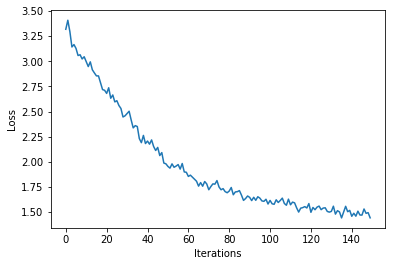

N/A%|#                                              |Time:  0:05:19  Loss: 1.44


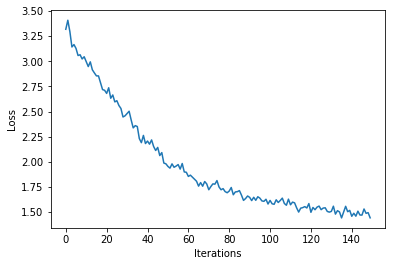

In [74]:
#training time 

epochs = 5
optimizer = tf.train.AdamOptimizer()
checkpointDir = './training_checkpoints'
checkpointPrefix = os.path.join(checkpointDir, "ckpt_{epoch}")

history = []
plotter = PeriodicPlotter(sec=1, xlabel="Iterations", ylabel="Loss")

for epoch in range(epochs):
    start = time.time()
    
    hidden = model.reset_states()
    
    custom_msg = custom_progress_text("Loss: %(loss)2.2f")
    bar = create_progress_bar(custom_msg)
    
    for inp, target in bar(dataset):
        with tf.GradientTape() as tape:
            predictions = model(inp)
            loss = computeLoss(target, predictions)
        
        grads = tape.gradient(loss, model.trainable_variables)
        optimizer.apply_gradients(zip(grads, model.trainable_variables))
        
        history.append(loss.numpy().mean())
        custom_msg.update_mapping(loss=history[-1])
        plotter.plot(history)
        
    model.save_weights(checkpointPrefix.format(epoch=epoch))
    

In [76]:
model = buildModel(vocabSize, embDim, rnnUnits, batchSize=1)

model.load_weights(tf.train.latest_checkpoint(checkpointDir))

model.build(tf.TensorShape((1, None)))

NameError: name 'checkpointDir' is not defined

In [100]:
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_7 (Embedding)      (1, None, 256)            21248     
_________________________________________________________________
lstm_7 (LSTM)                (1, None, 1024)           5246976   
_________________________________________________________________
dense_7 (Dense)              (1, None, 83)             85075     
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________


In [78]:
def generateText(model, startString, generationLength=1000): 
    
    input_eval = [char2idx[c] for c in startString]
    input_eval = tf.expand_dims(input_eval, 0)
    
    textGenerated = []
    model.reset_states()
    bar = create_progress_bar()
    
    for i in bar(range(generationLength)):
        predictions = model(input_eval)
        predictions = tf.squeeze(predictions, 0)
        predicted_id = tf.multinomial(predictions, num_samples=1)[-1,0].numpy()
        input_eval = tf.expand_dims([predicted_id], 0)
        
        textGenerated.append(idx2char[predicted_id])
                              
    return(startString + ''.join(textGenerated))

In [79]:
text = generateText(model, startString="X")

N/A%|                                                         |ETA:  --:--:--  

Instructions for updating:
Use tf.random.categorical instead.


100%|#########################################################|Time:  0:00:16  


In [52]:
startString = 'X'
input_eval1 = [char2idx[c] for c in startString]
input_eval = tf.expand_dims(input_eval1, 0)
input_eval

<tf.Tensor: id=5958, shape=(1, 1), dtype=int32, numpy=array([[49]], dtype=int32)>

In [110]:
play_generated_song(text)

Found 4 possible songs in generated texts


In [115]:
text2 = generateText(model, startString="X")

100%|#########################################################|Time:  0:00:15  


In [116]:
play_generated_song(text2)

Found 3 possible songs in generated texts


In [51]:
custom_msg = custom_progress_text("Loss: %(loss)2.2f")
bar = create_progress_bar(custom_msg)
    
for inp, target in bar(dataset):
    print(inp)

N/A%|#                                                |ETA:      N/A  Loss: nan

tf.Tensor(
[49 22 13  0 45 22 26 67 60 79 56 69 59 60 73  5 74  0 51 22  1 64 59 22
 59 58  9 63 70 73 69 71 64 71 60  9 13  0 38 22 28 82  0 37 22 13 11 20
  0 36 22 29  1 38 56 65 70 73  0  6 15 26 27 58 82 59 26 31 26  1 29 31
 26 59 82 61 59 58 59  1 31 26 59 61 82 62 61 62 60  1 61 60 61 59 82  6
 15 60 61 60], shape=(100,), dtype=int64)
tf.Tensor(
[ 6 15 59 58 27  1 26 14  1  6 15 26 27 58 82  2  0 59 26 31 26  1 29 31
 26 59 82 61 59 58 59  1 31 26 59 61 82 62 61 62 60  1 61 60 61 59 82  6
 15 60 61 60  1 59 58  1 59 14 22 82  2  0 26 32 82 31 26 59 26  1 31 26
 59 26 82 32 27 59 27  1 32 27 59 27 82 26 58 60 58  1 26 58 60 58 82 59
 61 56 61  1], shape=(100,), dtype=int64)
tf.Tensor(
[60 58 26 82  2  0 31 26 59 26  1 31 26 59 26 82 32 27 59 27  1 32 27 59
 27 82 26 58 60 62  1 61 60 61 59 82  6 15 60 61 60  1 59 58  1 59 14 22
 82  2  0  0 49 22 14  0 45 22 26 69  1 27 76 56 58 63 56 64 67 67  1 29
 73 60 70 64 75 60  0 51 22  1 64 59 22 59 58  9 63 70 73 69 71 64 71 60
  9 14 

N/A%|#                                                |ETA:      N/A  Loss: nan

tf.Tensor(
[69  0 30 32 82 26 15  1 32 30 26 82 29 15  1 32 30 29 82 26 15  1 32 30
 26 82 29 30 29  1 29 30 32 82  2  0 26 15  1 32 30 26 82 29 15  1 32 30
 29 82 26 15  1 32 30 26 82 29 30 29  1 29 22 82  2  0 30 32 82 26 27 58
  1 59 14 26 82 59 14 26  1 26 32 30 82 32 26 27  1 58 15 82 27 32 30  1
 30 29 30 82], shape=(100,), dtype=int64)
tf.Tensor(
[ 0 26 59 54 58  1 59 60 61 82 59 58 26  1 26 32 30 82 26 15  1 32 30 26
 82 29 30 29  1 29 22 82  2  0  0 49 22 16 13  0 45 22 31 73 64 60 81 60
  1 27 73 64 75 58 63 60 74  0 51 22  1 64 59 22 59 58  9 65 64 62  9 15
 17  0 38 22 18 11 20  0 37 22 13 11 20  0 36 22 29  1 38 64 79 70 67 80
 59 64 56 69], shape=(100,), dtype=int64)
tf.Tensor(
[30 82 31 30 29  1 30 31 32 82 26 59 27  1 58 26 32 82 26 15  1 27 26 32
 82 31 26 31  1 32 30 29 82  2  0 31 30 29  1 30 31 32 82 26 59 27  1 58
 26 32 82 31 15  1 32 30 28 82 29 30 29  1 29 14 22 82  2  0 26 82 59 14
 60  1 61 60 59 82 60 14 59  1 58 26 32 82 26 15  1 27 26 32 82 31 26 31
  1 32 

N/A%|#                                                |ETA:      N/A  Loss: nan

tf.Tensor(
[ 1 32 14 26 82 27 26 27  1 32 14 30 82 29 30 29  1 31 30 31 82 26 59 27
  1 26 31 29 82  2  0 30 29 30  1 32 14 26 82 27 26 27  1 62 61 60 82 59
 27 26  1 32 27 26 82 32 30 30  1 30 14 22 82  2  0 61 82 62 61 62  1 60
 14 61 82 62 61 62  1 60 61 62 82 61 60 61  1 59 14 60 82 61 60 61  1 59
 60 61 82  2], shape=(100,), dtype=int64)
tf.Tensor(
[52 13  1 62 61 62  1 60 14 61 82 62 61 62  1 60 59 27 82 59 27 26  1 32
 27 26 82 32 30 30  1 30 14 22 82  2  0 52 14  1 62 61 62  1 56 62 56 82
 57 62 60  1 60 59 27 82 59 27 26  1 32 27 26 82 32 30 30  1 30 14 82 53
  2  0  0 49 22 13 17 14  0 45 22 45 60 69 71 60 69 69 80  1 27 64 75  0
 51 22  1 64], shape=(100,), dtype=int64)
tf.Tensor(
[22 59 58  9 65 64 62  9 13 14 19  0 38 22 18 11 20  0 37 22 13 11 20  0
 36 22 26  1 29 70 73 64 56 69  0 62 61 82 60 26 26  1 60 26 26 82 27 26
 27  1 32 27 59 82 60 26 26  1 60 26 26 82 59 60 61  1 62 14 61 82  2  0
 60 26 26  1 60 26 26 82 27 26 27  1 32 27 59 82 60 59 60  1 62 59 27 82
 27 26 

N/A%|#                                                |ETA:      N/A  Loss: nan

tf.Tensor(
[27 32  1 32 14 22 82  2  0  0 49 22 13 20  0 45 22 31 64 69 69 64 74 63
  0 51 22  1 64 59 22 59 58  9 71 70 67 66 56  9 13 18  0 38 22 14 11 16
  0 37 22 13 11 20  0 36 22 27  1 38 64 69 70 73  0 27 25 58  1 27 58 82
 59 27  1 27 59 82 58 26  1 26 58 82 59 11 58 11 27 11 26 11  1 27 31 82
  2  0 27 25], shape=(100,), dtype=int64)
tf.Tensor(
[ 1 27 58 82 59 27  1 27 14 82 60 14  1 59 58 82 27 26  1 27 14 22 82  2
  0 61 14  1 59 61 82 60 58  1 58 59 82 60 61 11 60 11  1 59 58 82 27 58
  1 59 27 82  2  0 61 14  1 59 61 82 60 58  1 58 59 82 60 61 11 60 11  1
 59 58 82 27 26  1 27 14 22 82  2  0  0 49 22 13 21  0 45 22 31 70 73 75
 80  9 45 78], shape=(100,), dtype=int64)
tf.Tensor(
[ 1 41 70 76 69 59  1 28 63 60 72 76 60  0 51 22  1 64 59 22 59 58  9 71
 70 67 66 56  9 16 15  0 38 22 14 11 16  0 37 22 13 11 20  0 36 22 29  1
 38 56 65 70 73  0 59 11 27 11 82 26 59  1 27 59 11 27 11 82 26 29  1 31
 26 82 32 30  1 27 30 82 26 25 32  1 31 29 82  2  0 26 59  1 27 59 11 27
 11 82 

N/A%|#                                                |ETA:      N/A  Loss: nan

tf.Tensor(
[ 1 30 26 27 58 82 59 14 58 26  1 27 59 26 31 82 32 30 31 29  1 30 29 27
  8 29 82  2  0 26  8 29 29 14  1 26  8 29 31 26 82 27 31 26 31  1 30 26
 27 58 82 59 14 58 26  1 27 59 26 31 82 32 31 30 32  1 31 29 29 22 82  2
  0 60 82 61 59 59 14  1 61 59 62 60 82 61 59 62 61  1 60 59 27 58 82 59
 27 58 26  1], shape=(100,), dtype=int64)
tf.Tensor(
[58 59 60 82 61 59 62 61  1 60 14 59 60 82  2  0 52 13  1 61 59 59 14  1
 61 59 62 60 82 61 59 62 61  1 60 59 27 58 82 59 27 58 26  1 27 58 59 27
 82 26 31 30 31  1 29 15 22 82  2  0 52 14  1 61 62 56 61  1 60 61 59 26
 82 59 60 61 60  1 59 26 31 29 82 26  8 29 29 14  1 26  8 29 31 26 82 27
 31 26 31  1], shape=(100,), dtype=int64)
tf.Tensor(
[15 82 53  2  0  0 49 22 13 12 12  0 45 22 31 56 75 63 60 73  1 36 60 67
 67 80  5 74  1 39 70 10  1 13  0 51 22  1 64 59 22 59 58  9 73 60 60 67
  9 21 14  0 38 22 28  0 37 22 13 11 20  0 36 22 32  1 38 56 65 70 73  0
 32 26 82 27 14 32 27  1 26 32 30 32 82 29 32 32 31  1 32 14 26 27 82 58
 27 26 

N/A%|#                                                |ETA:      N/A  Loss: nan


tf.Tensor(
[60 61 62  1 56 57 56 62 82 61 59 58 26  1 27 26 27 58 82 53  2  0  0 49
 22 13 20 19  0 45 22 36 64 75 75 80  1 75 63 60  1 33 56 73 60  0 51 22
  1 64 59 22 59 58  9 73 60 60 67  9 15 20 21  0 38 22 28  0 37 22 13 11
 20  0 36 22 26  1 29 70 73 64 56 69  0 32 82 26 14 58 26  1 60 26 58 26
 82 60 26 56], shape=(100,), dtype=int64)
tf.Tensor(
[ 1 62 60 59 27 82 32 14 27 32  1 59 32 27 26 82 27 59 62 59  1 27 32 32
 27 82  2  0 26 14 58 26  1 60 26 58 26 82 60 26 56 26  1 62 60 59 27 82
 32 14 27 32  1 59 32 27 26 82 27 60 59 27  1 26 15 22 82  2  0 27 82 58
 14 58 27  1 58 60 59 27 82 32 14 27 32  1 29 32 27 32 82 58 14 58 27  1
 58 60 59 27], shape=(100,), dtype=int64)
tf.Tensor(
[32 26 27 32  1 26 15 27 82  2  0 52 13  1 58 14 58 27  1 58 60 59 27 82
 32 14 27 32  1 29 32 27 32 82 58 14 58 27  1 58 60 59 27 82 32 26 27 32
  1 26 15 22 82  2  0 52 14  1 58 26 26 14  1 58 26 31 26 82 32 29 27  8
 29  1 32  8 29 27  8 29 82 58 14 58 27  1 58 60 59 27 82 32 26 27 32  1
 26 15

N/A%|#                                                |ETA:      N/A  Loss: nan

tf.Tensor(
[59 82 60 59 27 59  1 26 14 31 26 82 27 14 26 31  1 32 31 30 29 82  2  0
 30 15 31  1 29 14 31 26 82 59 14 61 59  1 62 59 61 59 82 60 59 27 59  1
 26 14 31 26 82 27 59 26 32  1 31 29 29 14 22 82  2  0 61 59 59 14  1 61
 59 62 59 82 61 59 59 14  1 61 58 26 60 82 61 59 59 14  1 62 61 60 58 82
 59 61 56 62], shape=(100,), dtype=int64)
tf.Tensor(
[61 59 59 14 82  2  0 61 62 56 61  1 62 61 60 58 82 59 27 26 31  1 32 14
 31 32 82 26 14 32 27  1 26 27 59 60 82 61 56 60 62  1 61 59 59 14 22 82
  2  0  0 49 22 14 21 21  0 45 22 43 56 63 60 60 69  0 51 22  1 64 59 22
 59 58  9 73 60 60 67  9 14 19 19  0 38 22 28  0 37 22 13 11 20  0 36 22
 32  1 38 56], shape=(100,), dtype=int64)
tf.Tensor(
[70 73  0 27 82 59 15 60  1 59 27 32 26 82 27 15 32  1 26 32 30 32 82 59
 15 60  1 59 27 32 26 82 27 26 32 27  1 26 15 58 82  2  0 27 59 59 14  1
 60 14 59 27 82 59 15 27  1 26 32 30 32 82 27 15 32  1 26 32 30 32 82 29
 32 32 31  1 32 15 22 82  2  0 26 82 27 59 59 14  1 58 60 60 14 82 59 15
 60  1 

N/A%|#                                               |Time:  0:00:01  Loss: nan


tf.Tensor(
[32 32  1 32 31 32 82 26 14 32  1 31 32 26 82 27 32 32  1 32 31 32 82 26
 59 60  1 61 60 61 82  2  0 59 14 60  1 58 14 26 82 27 26 32  1 31 32 26
 82 27 32 26  1 31 29 31 82 32 15  1 32 14 22 82  2  0 27 82 59 62 62  1
 62 61 62 82 56 14 62  1 61 62 56 82 62 14 61  1 59 14 60 82 24 61 14 59
  1 58 14 60], shape=(100,), dtype=int64)
tf.Tensor(
[ 2  0 59 14 58  1 27 58 59 82 58 14 27  1 32 14 27 82 26 14 32  1 31 32
 26 82 32 14 31  1 29 14 82 53  2  0  0 49 22 21  0 45 22 33 76 69 75  0
 51 22  1 64 59 22 59 58  9 74 60 75 59 56 69 58 60  9 13 12  0 38 22 28
 82  0 37 22 13 11 20  0 36 22 32  1 38 56 65 70 73  0 29 14 82 32 26 27
 32  1 26 32], shape=(100,), dtype=int64)
tf.Tensor(
[32 82 58 27 58 60  1 59 58 27 26 82 32 26 27 32  1 26 32 30 29 82 30 26
 26 32  1 26 58 27 26 82  2  0 32 26 27 32  1 26 32 30 32 82 58 27 58 60
  1 59 58 27 26 82 32 26 27 32  1 26 32 30 29 82  6 15 30 31 32  1 31 26
  1 32 14 22 82  2  0 29 14 82 32 26 27 58  1 59 14 59 60 82 24 61 14 61
 14  1 